## 1. Import Library & Read Dataset Image

In [1]:
# Import library-library yang akan dibutuhkan pada eksperimen kali ini
import pandas as pd
import os
import matplotlib.pyplot as plt
plt.style.use("ggplot")
import numpy as np
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")
import tensorflow as tf
from tensorflow import keras
from PIL import Image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import cv2
from glob import glob
from keras.optimizers import SGD, Adam
from keras.layers import Dense, Dropout, Flatten
from tensorflow.keras.models import Sequential

In [3]:
# Memanggil semua data gambar dengan keempat kategori yang berbeda yang ada di dalam folder COVID-19_Radiography_Dataset
root_dataset_dir = "../../../COVID-19_Radiography_Dataset/"
covid19_images_data = root_dataset_dir + "COVID"
lung_opacity_images_data = root_dataset_dir + "Lung_Opacity"
normal_images_data = root_dataset_dir + "Normal"
pneumonia_images_data = root_dataset_dir + "Viral Pneumonia"

In [4]:
"""
Memanggil semua gambar dengan seluruh eksistensi gambar (.png/.jpg/.jpeg) yang ada
di dalam keempat DataFrame yang menampung data-data gambar berdasarkan kategorinya
"""
# Data gambar paru-paru manusia yang terkena virus covid-19
covid19_data = glob(covid19_images_data + "/*")

# Data gambar paru-paru dengan kategori penyakit yaitu lung opacity
lung_opacity_data = glob(lung_opacity_images_data + "/*")

# Data gambar dengan kategori paru-paru normal
normal_data = glob(normal_images_data + "/*")

# Data gambar dengan penyakit paru-paru denga kategori pneumonia
pneumonia_data = glob(pneumonia_images_data + "/*")

Keterangan:

Pada script diatas terdapat code dengan "/*" yang menandakan untuk mencocokan segala jenis eksistensi file yang ada di dalam folder tersebut untuk dipanggil ke dalam code. Sebagai contoh jika kita ingin hanya memanggil file dengan eksistensi .txt maka bisa gunakan script "/*.txt" atau jika ingin memanggil file yang hanya bereksistensi .jpg (karena pada eksperimen kali ini menggunakan data images) maka kita bisa menggunakan script "/*.jpg".

In [5]:
# Melihat jumlah masing-masing data gambar dari keempat kategori paru-paru (normal, covid-19, lung opacity atau pneumonia)
print("Nama Ketiga File dari Gambar Covid-19: ", covid19_data[0:3])
print("Jumlah Data pada Kategori Gambar Paru-Paru Covid-19: ", len(covid19_data), "\n")

print("Nama Ketiga File dari Gambar Lung Opacity: ", lung_opacity_data[0:3])
print("Jumlah Data pada Kategori Gambar Paru-Paru Lung Opacity: ", len(lung_opacity_data), "\n")

print("Nama Ketiga File dari Gambar Normal: ", normal_data[0:3])
print("Jumlah Data pada Kategori Gambar Paru-Paru Normal: ", len(normal_data), "\n")

print("Nama Ketiga File dari Gambar Pneumonia: ", pneumonia_data[0:3])
print("Jumlah Data pada Kategori Gambar Paru-Paru Pneumonia: ", len(pneumonia_data))

Nama Ketiga File dari Gambar Covid-19:  ['../../../COVID-19_Radiography_Dataset/COVID\\COVID-1.png', '../../../COVID-19_Radiography_Dataset/COVID\\COVID-10.png', '../../../COVID-19_Radiography_Dataset/COVID\\COVID-100.png']
Jumlah Data pada Kategori Gambar Paru-Paru Covid-19:  1797 

Nama Ketiga File dari Gambar Lung Opacity:  ['../../../COVID-19_Radiography_Dataset/Lung_Opacity\\Lung_Opacity-1.png', '../../../COVID-19_Radiography_Dataset/Lung_Opacity\\Lung_Opacity-10.png', '../../../COVID-19_Radiography_Dataset/Lung_Opacity\\Lung_Opacity-100.png']
Jumlah Data pada Kategori Gambar Paru-Paru Lung Opacity:  2000 

Nama Ketiga File dari Gambar Normal:  ['../../../COVID-19_Radiography_Dataset/Normal\\Normal-1.png', '../../../COVID-19_Radiography_Dataset/Normal\\Normal-10.png', '../../../COVID-19_Radiography_Dataset/Normal\\Normal-100.png']
Jumlah Data pada Kategori Gambar Paru-Paru Normal:  2000 

Nama Ketiga File dari Gambar Pneumonia:  ['../../../COVID-19_Radiography_Dataset/Viral Pneumo

In [6]:
"""
Mengecek resolusi/dimensi dari beberapa gambar x-ray
dari dua kategori/status kesehatan paru-paru yaitu Normal dan Pneumonia
"""

"""Beberapa List Resolusi/Dimensi Gambar X-Ray Paru-Paru Normal"""
print("--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Normal--------------------")

# Gambar x-ray dengan urutan file ke-1.798
normal_img1798_resolution = Image.open(str(normal_data[33]))
width, height = normal_img1798_resolution.size # .size merupakan sebuah function untuk memanggil ukuran pada suatu gambar

print("Dimensi Ukuran Gambar Urutan 1.798 pada Hasil X-Ray Normal adalah:", str(width) + "x" + str(height))

# Gambar x-ray dengan urutan ke-1.001
normal_img1001_resolution = Image.open(str(normal_data[22]))
width, height = normal_img1001_resolution.size

print("Dimensi Ukuran Gambar Urutan 1.001 pada Hasil X-Ray Normal adalah:", str(width) + "x" + str(height))

# Gambar x-ray dengan urutan ke-862
normal_img862_resolution = Image.open(str(normal_data[11]))
width, height = normal_img862_resolution.size

print("Dimensi Ukuran Gambar Urutan 862 pada Hasil X-Ray Normal adalah:", str(width) + "x" + str(height), "\n")

"""Beberapa List Resolusi/Dimensi Gambar X-Ray Paru-Paru Pneumonia"""
print("--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Pneumonia--------------------")

# Gambar x-ray 377
pneumonia_img377_resolution = Image.open(str(pneumonia_data[11]))
width, height = pneumonia_img377_resolution.size

print("Dimensi Ukuran Gambar Urutan 377 pada Hasil X-Ray Pneumonia adalah:", str(width) + "x" + str(height))

# Gambar x-ray 784
pneumonia_img784_resolution = Image.open(str(pneumonia_data[22]))
width, height = pneumonia_img784_resolution.size

print("Dimensi Ukuran Gambar Urutan 784 pada Hasil X-Ray Pneumonia adalah:", str(width) + "x" + str(height))

# Gambar x-ray 1.008
pneumonia_img1008_resolution = Image.open(str(pneumonia_data[44]))
width, height = pneumonia_img1008_resolution.size

print("Dimensi Ukuran Gambar Urutan 1.008 pada Hasil X-Ray Pneumonia adalah:", str(width) + "x" + str(height))

--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Normal--------------------
Dimensi Ukuran Gambar Urutan 1.798 pada Hasil X-Ray Normal adalah: 299x299
Dimensi Ukuran Gambar Urutan 1.001 pada Hasil X-Ray Normal adalah: 299x299
Dimensi Ukuran Gambar Urutan 862 pada Hasil X-Ray Normal adalah: 299x299 

--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Pneumonia--------------------
Dimensi Ukuran Gambar Urutan 377 pada Hasil X-Ray Pneumonia adalah: 299x299
Dimensi Ukuran Gambar Urutan 784 pada Hasil X-Ray Pneumonia adalah: 299x299
Dimensi Ukuran Gambar Urutan 1.008 pada Hasil X-Ray Pneumonia adalah: 299x299


In [7]:
"""
Mengecek resolusi/dimensi dari beberapa gambar x-ray
dari dua kategori/status kesehatan paru-paru yaitu covid-19 dan Lung Opacity
"""

"""Beberapa List Resolusi/Dimensi Gambar X-Ray Paru-Paru Covid-19"""
print("--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Covid-19--------------------")

# Gambar x-ray pertama
covid19_img1_resolution = Image.open(str(covid19_data[0]))
width, height = covid19_img1_resolution.size # .size merupakan sebuah function untuk memanggil ukuran pada suatu gambar

print("Dimensi Ukuran Gambar Urutan 1 pada Hasil X-Ray Covid-19 adalah:", str(width) + "x" + str(height))

# Gambar x-ray dengan urutan ke-53
covid19_img53_resolution = Image.open(str(covid19_data[11]))
width, height = covid19_img53_resolution.size

print("Dimensi Ukuran Gambar Urutan 53 pada Hasil X-Ray Covid-19 adalah:", str(width) + "x" + str(height))

# Gambar x-ray dengan urutan ke-67
covid19_img67_resolution = Image.open(str(covid19_data[22]))
width, height = covid19_img67_resolution.size

print("Dimensi Ukuran Gambar Urutan 67 pada Hasil X-Ray Covid-19 adalah:", str(width) + "x" + str(height), "\n")

"""Beberapa List Resolusi/Dimensi Gambar X-Ray Paru-Paru Lung Opacity"""
print("--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Lung Opacity--------------------")

# Gambar x-ray kelima
lungopacity_img5_resolution = Image.open(str(lung_opacity_data[33]))
width, height = lungopacity_img5_resolution.size

print("Dimensi Ukuran Gambar Urutan 5 pada Hasil X-Ray Lung Opacity adalah:", str(width) + "x" + str(height))

# Gambar x-ray 39
lungopacity_img39_resolution = Image.open(str(lung_opacity_data[39]))
width, height = lungopacity_img39_resolution.size

print("Dimensi Ukuran Gambar Urutan 39 pada Hasil X-Ray Lung Opacity adalah:", str(width) + "x" + str(height))

# Gambar x-ray 119
lungopacity_img119_resolution = Image.open(str(lung_opacity_data[45]))
width, height = lungopacity_img119_resolution.size

print("Dimensi Ukuran Gambar Urutan 119 pada Hasil X-Ray Lung Opacity adalah:", str(width) + "x" + str(height))

--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Covid-19--------------------
Dimensi Ukuran Gambar Urutan 1 pada Hasil X-Ray Covid-19 adalah: 299x299
Dimensi Ukuran Gambar Urutan 53 pada Hasil X-Ray Covid-19 adalah: 299x299
Dimensi Ukuran Gambar Urutan 67 pada Hasil X-Ray Covid-19 adalah: 299x299 

--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Lung Opacity--------------------
Dimensi Ukuran Gambar Urutan 5 pada Hasil X-Ray Lung Opacity adalah: 299x299
Dimensi Ukuran Gambar Urutan 39 pada Hasil X-Ray Lung Opacity adalah: 299x299
Dimensi Ukuran Gambar Urutan 119 pada Hasil X-Ray Lung Opacity adalah: 299x299


## 2. Eksplorasi Data Gambar berdasarkan Keempat Kategori dari Paru-Paru

### 2.1. Menampilkan Salah Satu Gambar dari Keempat Kategori Data X-Ray Images Paru-Paru yaitu Covid-19, Lung Opacity, Normal dan Pneumonia

#### 2.1.1. Gambar X-Ray Paru-Paru Covid-19

../../../COVID-19_Radiography_Dataset/COVID\COVID-1.png


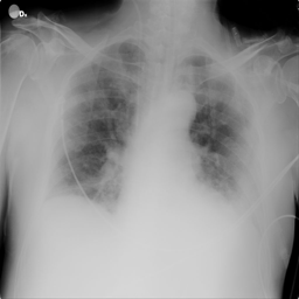

In [8]:
# Menampilkan salah satu gambar dari paru-paru yang terindikasi terkena virus covid-19
covid_image = list(covid19_data)
print(covid_image[0])

# Membuka gambar dengan indeks array pertama atau dengan kata lain melihat gambar pertama dari paru-paru covid-19
Image.open(str(covid_image[0]))

#### 2.1.2. Gambar X-Ray Paru-Paru Lung Opacity

../../../COVID-19_Radiography_Dataset/Lung_Opacity\Lung_Opacity-1008.png


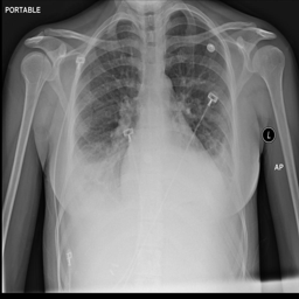

In [9]:
# Menampilkan salah satu gambar dari paru-paru yang terindikasi terkena penyakit lung opacity
lung_opacity_image = list(lung_opacity_data)
print(lung_opacity_image[11])

"""
Membuka gambar dengan indeks array 11 dari list gambar yang tersimpan pada local device
atau dengan kata lain melihat gambar keempat dari paru-paru yang terindikasi penyakit dengan kategori lung opacity
"""
Image.open(str(lung_opacity_image[11]))

#### 2.1.3. Gambar X-Ray Paru-Paru Normal

../../../COVID-19_Radiography_Dataset/Normal\Normal-1003.png


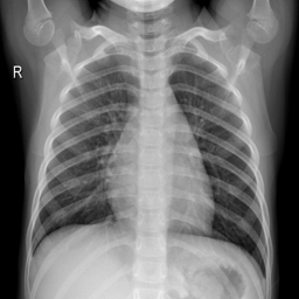

In [10]:
"""
Menampilkan salah satu gambar dari paru-paru normal
(yang tidak terindikasi penyakit apapun seperti covid-19/lung opacity dan pneumonia)
"""
normal_lung_image = list(normal_data)
print(normal_lung_image[6])

"""
Membuka gambar dengan indeks array keenam dari list gambar yang tersimpan pada local device
atau dengan kata lain melihat gambar ketujuh dari paru-paru yang memliki kategori normal
"""
Image.open(str(normal_lung_image[6]))

#### 2.1.4. Gambar X-Ray Paru-Paru Pneumonia

../../../COVID-19_Radiography_Dataset/Viral Pneumonia\Viral Pneumonia-1015.png


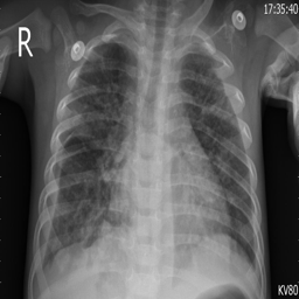

In [11]:
# Menampilkan salah satu gambar dari paru-paru yang terindikasi terkena penyakit pneumonia
pneumonia_lung_image = list(pneumonia_data)
print(pneumonia_lung_image[19])

"""
Membuka gambar dengan indeks array 19 dari list gambar yang tersimpan pada local device
atau dengan kata lain melihat gambar ke-20 dari paru-paru yang terindikasi penyakit dengan kategori pneumonia
"""
Image.open(str(pneumonia_lung_image[19]))

### 2.2. Menampilkan Beberapa Gambar yang Membentuk Horizontal (Berdasarkan Baris) dari Keempat Kategori Data X-Ray Images Paru-Paru yaitu Covid-19, Lung Opacity, Normal dan Pneumonia

#### 2.2.1 Kumpulan Gambar dari Data X-Ray Covid-19

Kumpulan Gambar Paru-Paru yang Terkena Virus Covid-19: 


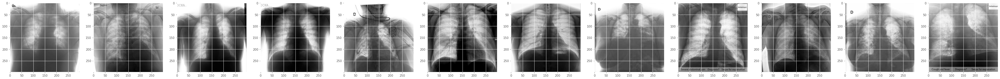

In [12]:
# Menampilkan 12 list/kumpulan gambar dari paru-paru yang terindikasi covid-19 dengan cara melakukan perulangan
for covid in range (1):
    fig, axs = plt.subplots(1, 12, figsize=(60, 55))
    print("Kumpulan Gambar Paru-Paru yang Terkena Virus Covid-19: ")
    covid = list(covid19_data)
    covid_path = [k for k in covid19_data]
    
    for i in range (12):
        covid_imgs = keras.preprocessing.image.img_to_array(
            keras.preprocessing.image.load_img(covid_path[i], color_mode="grayscale"))
        axs[i].imshow(covid_imgs, cmap="Greys")
    plt.show()

Berdasarkan dari script diatas terdapat beberapa penjelasan yang harus diketahui dan berikut adalah penjelasannya:

1. for covid in range (1) dan for i in range (12) merupakan teknik dalam membuat konsep perulangan yang digunakan dalam eksperimen kali ini yang bertujuan untuk menampilkan data gambar dengan status kategori paru-paru terkena covid. Range (1) tersebut berfungsi hanya untuk menampilkan 1 bagian yang nantinya akan menampung gambar-gambar yang berjumlah dua belas paru-paru covid-19 dari hasil scan x-ray karena maksud dari range (12) adalah menampilkan gambar sebanyak 12x. Jika gambar sudah di-load 12 kali maka perulangan akan dihentikan.
2. fig dan axs adalah figure dan axis yang memiliki perbedaan fungsi namun tetap saling berkaitan. Fig/figure merupakan halaman objek visual tempat letaknya gambar. Kemudian axs/axis merupakan area yang dimana tempat diletakkannya data gambar tersebut.
3. plt.subplots(1, 12, figsize=(60, 55)) bertujuan untuk menempatkan/memasukkan gambar dengan sifat vertikal pada 1 figure (fig) yang mencakup gambar dari indeks pertama hingga indeks dua belas dengan ukuran yaitu 60 untuk panjang 1 gambar dan 55 untuk lebar dalam 1 gambar. Jadi intinya kumpulan gambar yang ditampilkan hanya sebanyak 12 gambar saja.
4. Variabel "covid" yang berisikan list dari variabel "covid19_data" memiliki tujuan yaitu variabel "covid" mengambil semua isi data yang ada di dalam variabel "covid19_data" dan ditampilkan ke dalam bentuk list.
5. Variabel "covid_path" terkoneksi atau sangat berkaitan dengan variabel "covid_imgs" yang dimana kedua variabel ini bertujuan untuk melakukan proses load data gambar ke dalam tempat figure yang telah disiapkan. Gambar-gambar tersebut nantinya akan di-load sebanyak 12 kali dan jika sudah 12x gambar ditampilkan maka proses perulangan akan segera berhenti.
6. axs[i].imshow bertujuan untuk menampilkan gambar-gambar yang berhasil di-load ke dalam figure dan nantinya figure tersebut akan terbagi menjadi 12 axis/12 bagian (sesuai dengan gambar yang ingin ditampilkan).

#### 2.2.2. Kumpulan Gambar dari Data X-Ray Lung Opacity

Kumpulan Gambar Paru-Paru yang Lung Opacity: 


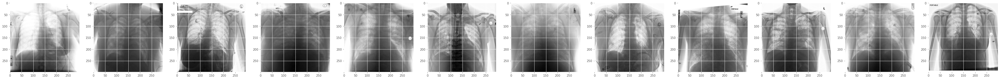

In [13]:
# Menampilkan 12 list/kumpulan gambar dari paru-paru yang terindikasi lung opacity dengan cara melakukan perulangan
for lung_opacity in range (1):
    fig, axs = plt.subplots(1, 12, figsize=(60, 55))
    print("Kumpulan Gambar Paru-Paru yang Lung Opacity: ")
    lungopacity = list(lung_opacity_data)
    lungopacity_path = [k for k in lung_opacity_data]
    
    for i in range (12):
        lung_opacity_imgs = keras.preprocessing.image.img_to_array(
            keras.preprocessing.image.load_img(lungopacity_path[i], color_mode="grayscale"))
        axs[i].imshow(lung_opacity_imgs, cmap="Greys")
    plt.show()

Berdasarkan dari script diatas terdapat beberapa penjelasan yang harus diketahui dan berikut adalah penjelasannya:

1. for lung_opacity in range (1) dan for i in range (12) merupakan teknik dalam membuat konsep perulangan yang digunakan dalam eksperimen kali ini yang bertujuan untuk menampilkan data gambar dengan status kategori paru-paru lung opacity. Range (1) tersebut berfungsi hanya untuk menampilkan 1 bagian yang nantinya akan menampung gambar-gambar yang berjumlah dua belas paru-paru lung opacity dari hasil scan x-ray karena maksud dari range (12) adalah menampilkan gambar sebanyak 12x. Jika gambar sudah di-load 12 kali maka perulangan akan dihentikan.
2. fig dan axs adalah figure dan axis yang memiliki perbedaan fungsi namun tetap saling berkaitan. Fig/figure merupakan halaman objek visual tempat letaknya gambar. Kemudian axs/axis merupakan area yang dimana tempat diletakkannya data gambar tersebut.
3. plt.subplots(1, 12, figsize=(60, 55)) bertujuan untuk menempatkan/memasukkan gambar dengan sifat vertikal pada 1 figure (fig) yang mencakup gambar dari indeks pertama hingga indeks dua belas dengan ukuran yaitu 60 untuk panjang 1 gambar dan 55 untuk lebar dalam 1 gambar. Jadi intinya kumpulan gambar yang ditampilkan hanya sebanyak 12 gambar saja.
4. Variabel "lungopacity" yang berisikan list dari variabel "lung_opacity_data" memiliki tujuan yaitu variabel "lungopacity" mengambil semua isi data yang ada di dalam variabel "lung_opacity_data" dan ditampilkan ke dalam bentuk list.
5. Variabel "lungopacity_path" terkoneksi atau sangat berkaitan dengan variabel "lung_opacity_imgs" yang dimana kedua variabel ini bertujuan untuk melakukan proses load data gambar ke dalam tempat figure yang telah disiapkan. Gambar-gambar tersebut nantinya akan di-load sebanyak 12 kali dan jika sudah 12x gambar ditampilkan maka proses perulangan akan segera berhenti.
6. axs[i].imshow bertujuan untuk menampilkan gambar-gambar yang berhasil di-load ke dalam figure dan nantinya figure tersebut akan terbagi menjadi 12 axis/12 bagian (sesuai dengan gambar yang ingin ditampilkan).

#### 2.2.3. Kumpulan Gambar dari Data X-Ray Normal

Kumpulan Gambar Paru-Paru yang Normal (Tanpa Terindikasi/Terkena Virus atau Penyakit): 


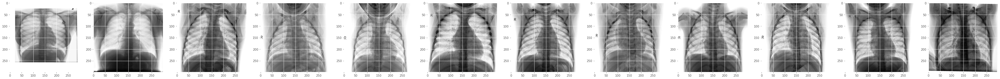

In [14]:
# Menampilkan 12 list/kumpulan gambar dari paru-paru yang normal (tidak terkena apapun) dengan cara melakukan perulangan
for normal in range (1):
    fig, axs = plt.subplots(1, 12, figsize=(60, 55))
    print("Kumpulan Gambar Paru-Paru yang Normal (Tanpa Terindikasi/Terkena Virus atau Penyakit): ")
    normal = list(normal_data)
    normal_path = [k for k in normal_data]
    
    for i in range (12):
        normal_imgs = keras.preprocessing.image.img_to_array(
            keras.preprocessing.image.load_img(normal_path[i], color_mode="grayscale"))
        axs[i].imshow(normal_imgs, cmap="Greys")
    plt.show()

Berdasarkan dari script diatas terdapat beberapa penjelasan yang harus diketahui dan berikut adalah penjelasannya:

1. for normal in range (1) dan for i in range (12) merupakan teknik dalam membuat konsep perulangan yang digunakan dalam eksperimen kali ini yang bertujuan untuk menampilkan data gambar dengan status kategori paru-paru normal. Range (1) tersebut berfungsi hanya untuk menampilkan 1 bagian yang nantinya akan menampung gambar-gambar yang berjumlah dua belas paru-paru normal dari hasil scan x-ray karena maksud dari range (12) adalah menampilkan gambar sebanyak 12x. Jika gambar sudah di-load 12 kali maka perulangan akan dihentikan.
2. fig dan axs adalah figure dan axis yang memiliki perbedaan fungsi namun tetap saling berkaitan. Fig/figure merupakan halaman objek visual tempat letaknya gambar. Kemudian axs/axis merupakan area yang dimana tempat diletakkannya data gambar tersebut.
3. plt.subplots(1, 12, figsize=(60, 55)) bertujuan untuk menempatkan/memasukkan gambar dengan sifat vertikal pada 1 figure (fig) yang mencakup gambar dari indeks pertama hingga indeks dua belas dengan ukuran yaitu 60 untuk panjang 1 gambar dan 55 untuk lebar dalam 1 gambar. Jadi intinya kumpulan gambar yang ditampilkan hanya sebanyak 12 gambar saja.
4. Variabel "normal" yang berisikan list dari variabel "normal_data" memiliki tujuan yaitu variabel "normal" mengambil semua isi data yang ada di dalam variabel "normal_data" dan ditampilkan ke dalam bentuk list.
5. Variabel "normal_path" terkoneksi atau sangat berkaitan dengan variabel "normal_imgs" yang dimana kedua variabel ini bertujuan untuk melakukan proses load data gambar ke dalam tempat figure yang telah disiapkan. Gambar-gambar tersebut nantinya akan di-load sebanyak 12 kali dan jika sudah 12x gambar ditampilkan maka proses perulangan akan segera berhenti.
6. axs[i].imshow bertujuan untuk menampilkan gambar-gambar yang berhasil di-load ke dalam figure dan nantinya figure tersebut akan terbagi menjadi 12 axis/12 bagian (sesuai dengan gambar yang ingin ditampilkan).

#### 2.2.4. Kumpulan Gambar dari Data X-Ray Pneumonia

Kumpulan Gambar Paru-Paru yang Terkena Penyakit Pneumonia: 


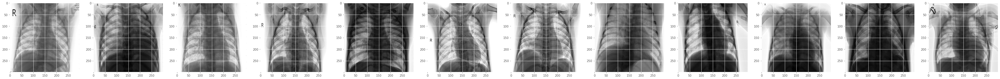

In [15]:
# Menampilkan 12 list/kumpulan gambar dari paru-paru yang terindikasi penyakit pneumonia dengan cara melakukan perulangan
for pneumonia in range (1):
    fig, axs = plt.subplots(1, 12, figsize=(60, 55))
    print("Kumpulan Gambar Paru-Paru yang Terkena Penyakit Pneumonia: ")
    pneumonia = list(pneumonia_data)
    pneumonia_path = [k for k in pneumonia_data]
    
    for i in range (12):
        pneumonia_imgs = keras.preprocessing.image.img_to_array(
            keras.preprocessing.image.load_img(pneumonia_path[i], color_mode="grayscale"))
        axs[i].imshow(pneumonia_imgs, cmap="Greys")
    plt.show()

Berdasarkan dari script diatas terdapat beberapa penjelasan yang harus diketahui dan berikut adalah penjelasannya:

1. for pneumonia in range (1) dan for i in range (12) merupakan teknik dalam membuat konsep perulangan yang digunakan dalam eksperimen kali ini yang bertujuan untuk menampilkan data gambar dengan status kategori paru-paru pneumonia. Range (1) tersebut berfungsi hanya untuk menampilkan 1 bagian yang nantinya akan menampung gambar-gambar yang berjumlah dua belas paru-paru pneumonia dari hasil scan x-ray karena maksud dari range (12) adalah menampilkan gambar sebanyak 12x. Jika gambar sudah di-load 12 kali maka perulangan akan dihentikan.
2. fig dan axs adalah figure dan axis yang memiliki perbedaan fungsi namun tetap saling berkaitan. Fig/figure merupakan halaman objek visual tempat letaknya gambar. Kemudian axs/axis merupakan area yang dimana tempat diletakkannya data gambar tersebut.
3. plt.subplots(1, 12, figsize=(60, 55)) bertujuan untuk menempatkan/memasukkan gambar dengan sifat vertikal pada 1 figure (fig) yang mencakup gambar dari indeks pertama hingga indeks dua belas dengan ukuran yaitu 60 untuk panjang 1 gambar dan 55 untuk lebar dalam 1 gambar. Jadi intinya kumpulan gambar yang ditampilkan hanya sebanyak 12 gambar saja.
4. Variabel "pneumonia" yang berisikan list dari variabel "pneumonia_data" memiliki tujuan yaitu variabel "pneumonia" mengambil semua isi data yang ada di dalam variabel "pneumonia_data" dan ditampilkan ke dalam bentuk list.
5. Variabel "pneumonia_paths" terkoneksi atau sangat berkaitan dengan variabel "pneumonia_imgs" yang dimana kedua variabel ini bertujuan untuk melakukan proses load data gambar ke dalam tempat figure yang telah disiapkan. Gambar-gambar tersebut nantinya akan di-load sebanyak 12 kali dan jika sudah 12x gambar ditampilkan maka proses perulangan akan segera berhenti.
6. axs[i].imshow bertujuan untuk menampilkan gambar-gambar yang berhasil di-load ke dalam figure dan nantinya figure tersebut akan terbagi menjadi 12 axis/12 bagian (sesuai dengan gambar yang ingin ditampilkan).

### 2.3. Menampilkan 35 Gambar Hasil X-Ray Paru-Paru yaitu Covid-19, Lung Opacity, Normal dan Pneumonia

#### 2.3.1. Gambar X-Ray dari Paru-Paru dengan Status Covid-19

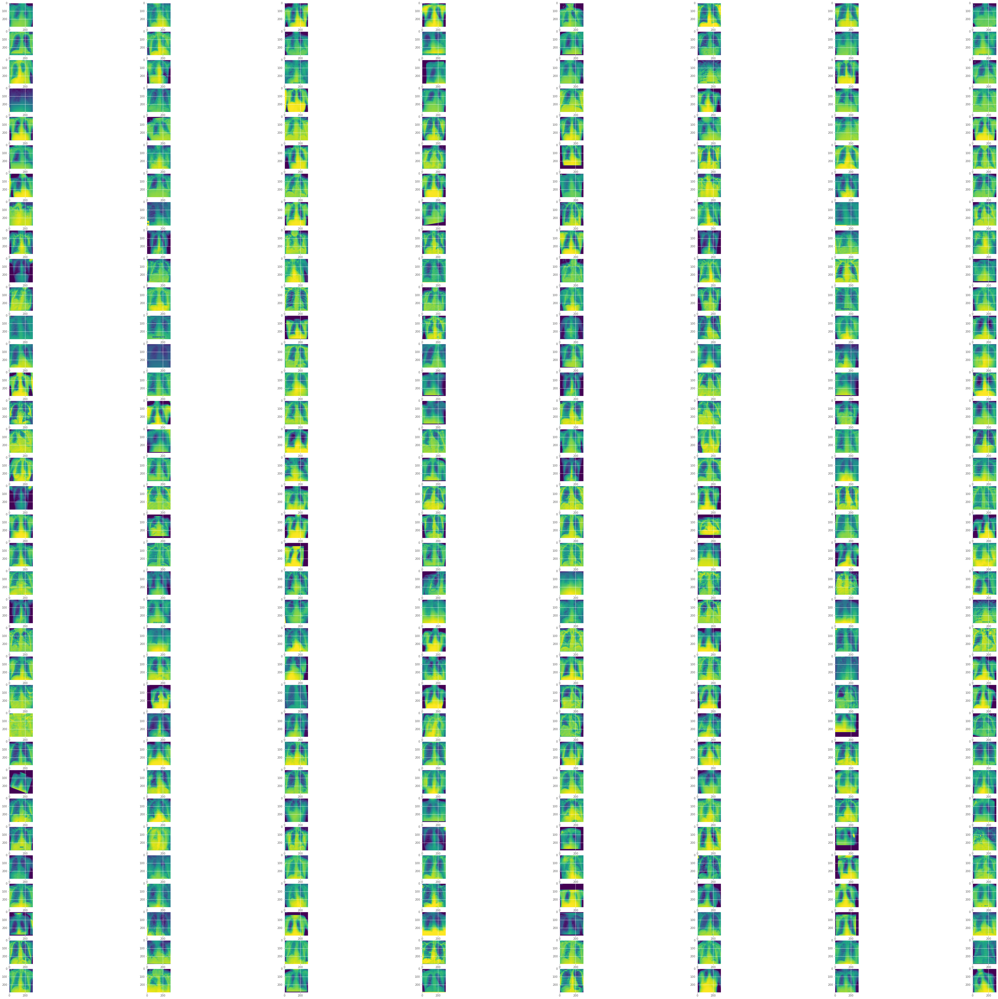

In [16]:
# Menampilkan 35 gambar yang diisi ke dalam 8 kolom yang berupa hasil x-ray paru-paru yang terkena virus covid-19
fig = plt.figure(figsize=(70, 66))

rows = 35 # Baris code ini bertujuan untuk menampilkan 35 gambar hasil x-ray yang nantinya akan disesuaikan oleh kolom
cols = 8 # Baris code ini bertujuan untuk memasukkan gambar-gambar hasil x-ray ke dalam kolom-kolom yang telah disiapkan

# Melakukan proses perulangan untuk menampilkan gambar sebanyak 35 baris yang diinput ke dalam 8 kolom
for multiple_covid_images in range(0, rows * cols):
    fig.add_subplot(rows, cols, multiple_covid_images + 1)
    images = plt.imread(covid19_data[multiple_covid_images])
    plt.imshow(images)
    
plt.show()

#### 2.3.2. Gambar X-Ray dari Paru-Paru dengan Status Long Opacity

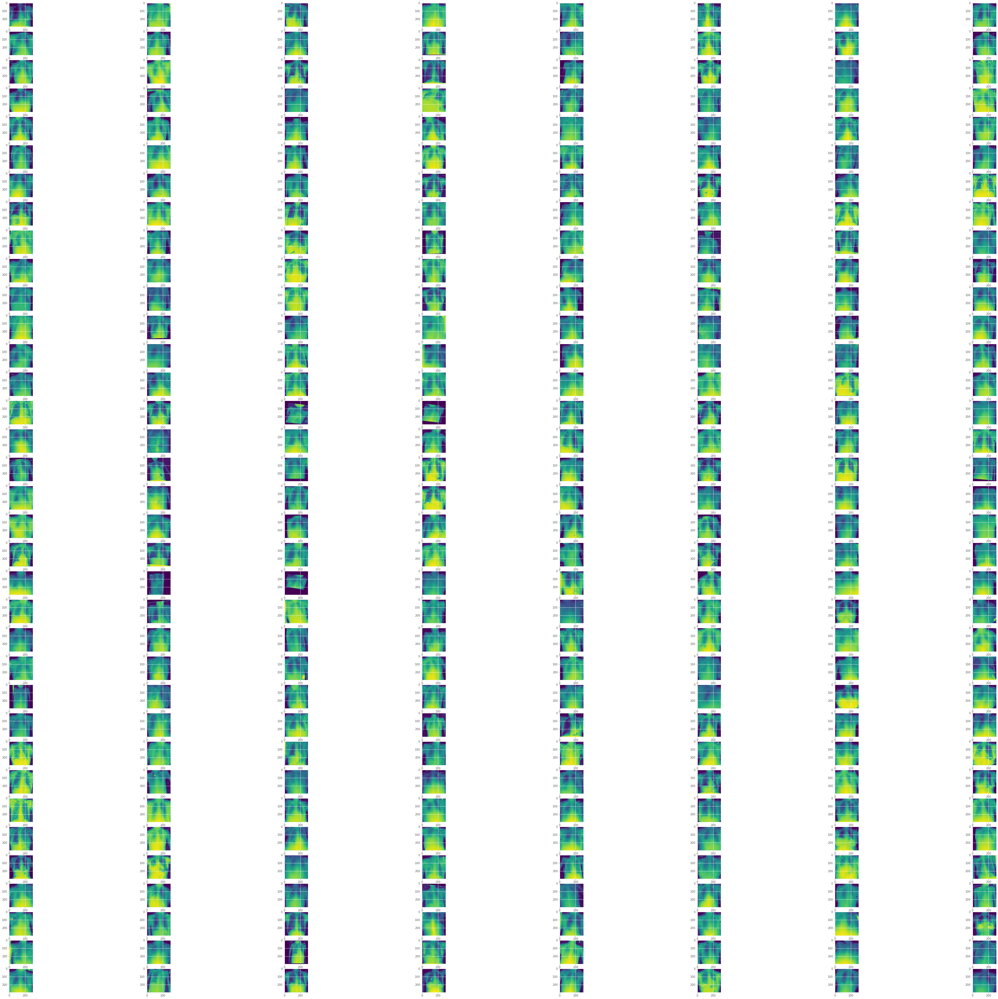

In [17]:
# Menampilkan 35 gambar yang diisi ke dalam 8 kolom yang berupa hasil x-ray paru-paru yang terkena lung opacity
fig = plt.figure(figsize=(70, 66))

rows = 35 # Baris code ini bertujuan untuk menampilkan 35 gambar hasil x-ray yang nantinya akan disesuaikan oleh kolom
cols = 8 # Baris code ini bertujuan untuk memasukkan gambar-gambar hasil x-ray ke dalam kolom-kolom yang telah disiapkan

# Melakukan proses perulangan untuk menampilkan gambar sebanyak 35 baris yang diinput ke dalam 8 kolom
for multiple_lung_opacity_images in range(0, rows * cols):
    fig.add_subplot(rows, cols, multiple_lung_opacity_images + 1)
    images = plt.imread(lung_opacity_data[multiple_lung_opacity_images])
    plt.imshow(images)
    
plt.show()

#### 2.3.3. Gambar X-Ray dari Paru-Paru dengan Status Normal

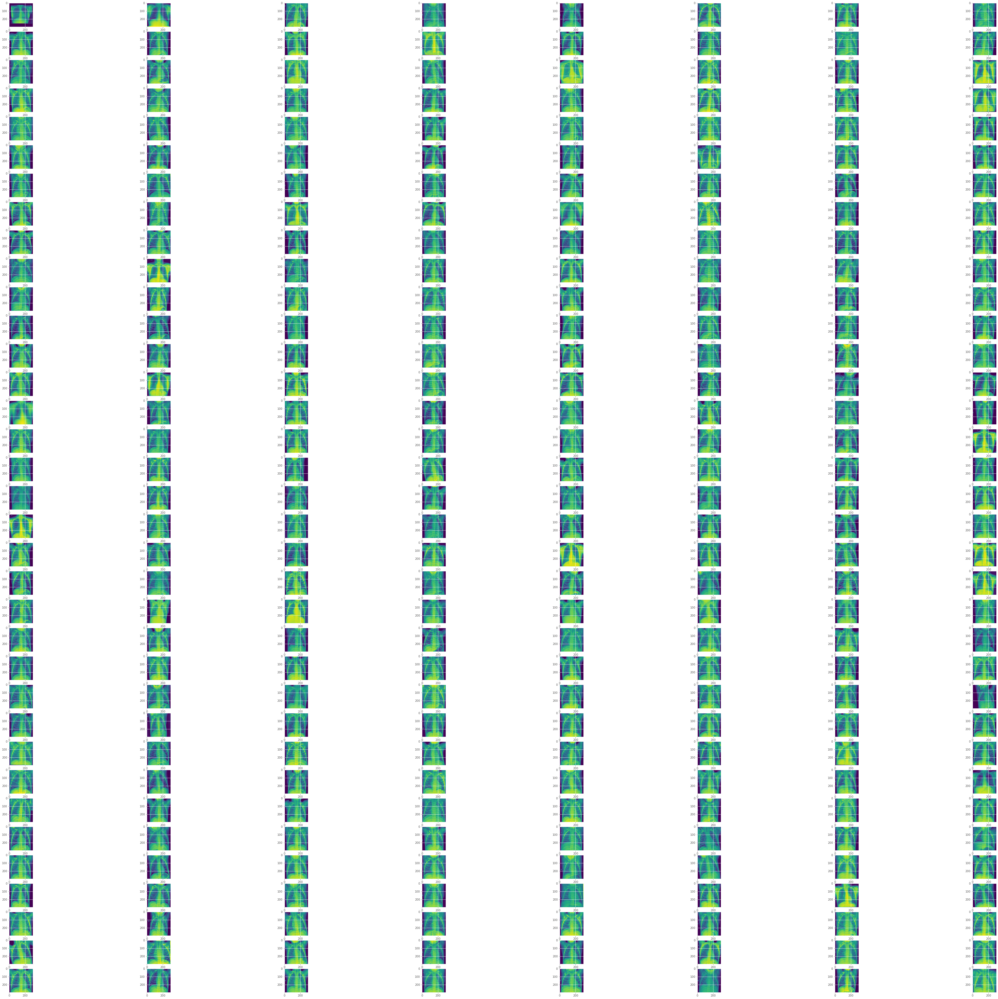

In [18]:
# Menampilkan 35 gambar yang diisi ke dalam 8 kolom yang berupa hasil x-ray paru-paru dengan status/kategori normal
fig = plt.figure(figsize=(70, 66))

rows = 35 # Baris code ini bertujuan untuk menampilkan 35 gambar hasil x-ray yang nantinya akan disesuaikan oleh kolom
cols = 8 # Baris code ini bertujuan untuk memasukkan gambar-gambar hasil x-ray ke dalam kolom-kolom yang telah disiapkan

# Melakukan proses perulangan untuk menampilkan gambar sebanyak 35 baris yang diinput ke dalam 8 kolom
for multiple_normal_images in range(0, rows * cols):
    fig.add_subplot(rows, cols, multiple_normal_images + 1)
    images = plt.imread(normal_data[multiple_normal_images])
    plt.imshow(images)
    
plt.show()

#### 2.3.4. Gambar X-Ray dari Paru-Paru dengan Status Pneumonia

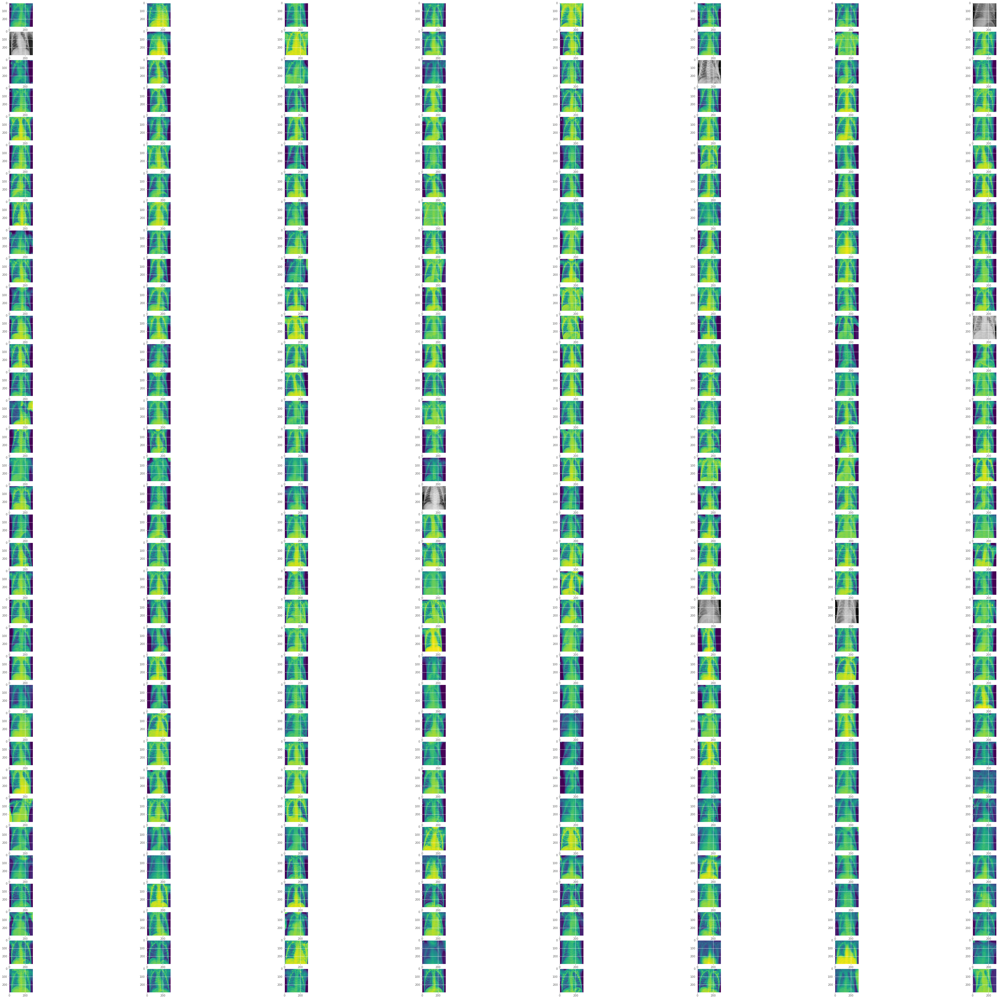

In [19]:
# Menampilkan 35 gambar yang diisi ke dalam 8 kolom yang berupa hasil x-ray paru-paru yang terkena atau dengan status pneumonia
fig = plt.figure(figsize=(70, 66))

rows = 35 # Baris code ini bertujuan untuk menampilkan 35 gambar hasil x-ray yang nantinya akan disesuaikan oleh kolom
cols = 8 # Baris code ini bertujuan untuk memasukkan gambar-gambar hasil x-ray ke dalam kolom-kolom yang telah disiapkan

# Melakukan proses perulangan untuk menampilkan gambar sebanyak 35 baris yang diinput ke dalam 8 kolom
for multiple_pneumonia_images in range(0, rows * cols):
    fig.add_subplot(rows, cols, multiple_pneumonia_images + 1)
    images = plt.imread(pneumonia_data[multiple_pneumonia_images])
    plt.imshow(images)
    
plt.show()

## 3. Image Preprocessing

### 3.1. Data Augmentation

In [20]:
"""
Melakukan proses augmentasi gambar agar saat proses pelatihan dengan algoritma ResNet 152 v2
memiliki banyak variasi data yang berasal dari 4 label yaitu COVID, Lung_Opacity, Normal dan Viral Pneumonia
Augmentasi gambar yang akan dilakukan di dalam eksperimen ini adalah vertical_flip, horizontal_flip,
rotation_range, width_shift_range, height_shift_range, shear_range dan validation_split
"""

"""
Proses augmentasi pada setiap data gambar untuk keempat label kategori yaitu COVID, Lung_Opacity,
Normal, Viral Pneumonia yang akan digunakan dalam proses pelatihan algoritma dengan data latih
"""
data_train_augmentation = ImageDataGenerator(vertical_flip=True, horizontal_flip=True, rotation_range=2,
                                             width_shift_range=0.2, height_shift_range=0.2, shear_range=0.3,
                                             rescale=None, validation_split=0.2)

# Proses augmentasi pada setiap data gambar yang bertujuan untuk menguji algoritma dengan data latihnya
data_test_augmentation = ImageDataGenerator(rescale=None, validation_split=0.2)

In [21]:
"""
Memasukkan variabel data_train_augmentation yang bertujuan untuk memberikan variasi data-data baru ke dalam data pelatihan
serta juga memasukkan variabel data_test_augmentation yang di dalamnya terdapat nilai hasil split saja
"""
training_generator = data_train_augmentation.flow_from_directory("../../../COVID-19_Radiography_Dataset",
                                                                 target_size=(100, 100),
                                                                 subset="training",
                                                                 classes=("COVID", "Lung_Opacity", "Normal", "Viral Pneumonia"),
                                                                 color_mode="rgb",
                                                                 class_mode="categorical",
                                                                 shuffle=True,
                                                                 batch_size=32)

print()

testing_generator = data_test_augmentation.flow_from_directory("../../../COVID-19_Radiography_Dataset",
                                                               target_size=(100, 100),
                                                               subset="validation",
                                                               classes=("COVID", "Lung_Opacity", "Normal", "Viral Pneumonia"),
                                                               color_mode="rgb",
                                                               class_mode="categorical",
                                                               shuffle=True,
                                                               batch_size=32)

Found 5714 images belonging to 4 classes.

Found 1428 images belonging to 4 classes.


In [25]:
# Melihat nama-nama dari kelas yang digunakan dalam pengujian kali ini, baik dari training generator atau testing generator

# Khusus untuk nama-nama kelas dari dictionary data latih
class_dictionary_train = training_generator.class_indices
class_dictionary_train = { value:key for key, value in class_dictionary_train.items()}
"""
Melakukan proses konversi dictionary (class_dictionary_train) yang telah
berisikan nama-nama label dari masing-masing gambar di data latih ke dalam list
"""
class_list_train = [value for _,value in class_dictionary_train.items()]
print(class_list_train)

# Khusus untuk nama-nama kelas dari dictionary data uji
class_dictionary_test = testing_generator.class_indices
class_dictionary_test = { value:key for key, value in class_dictionary_test.items()}
"""
Melakukan proses konversi dictionary (class_dictionary_test) yang telah
berisikan nama-nama label dari masing-masing gambar di data uji ke dalam list
"""
class_list_test = [value for _,value in class_dictionary_test.items()]
print(class_list_test)

['COVID', 'Lung_Opacity', 'Normal', 'Viral Pneumonia']
['COVID', 'Lung_Opacity', 'Normal', 'Viral Pneumonia']


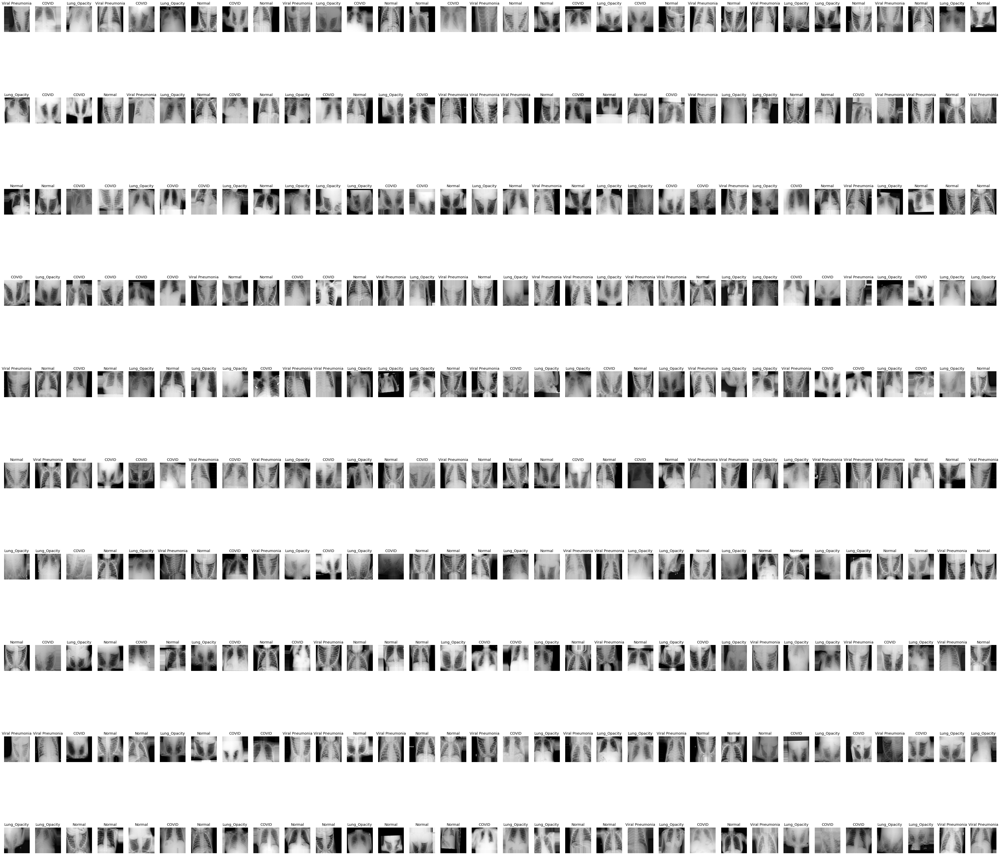

In [23]:
# Menampilkan data-data yang berada dari keempat label (COVID, Lung_Opacity, Normal, Viral Pneumonia) setelah di augmentasi
rows = 10
batch_size = 32
fig, axes = plt.subplots(rows, batch_size)

for r in range(rows):
    image_batch = training_generator.next()    
    images_count = image_batch[0].shape[0]
    
    for c in range(images_count):
        image = image_batch[0][c].astype("uint8")
        axes[r, c].imshow(image)
        axes[r, c].title.set_text(class_list_train[np.argmax(image_batch[1][c])])
        axes[r, c].set_xticks([])
        axes[r, c].set_yticks([])
fig.set_size_inches(70, 65)

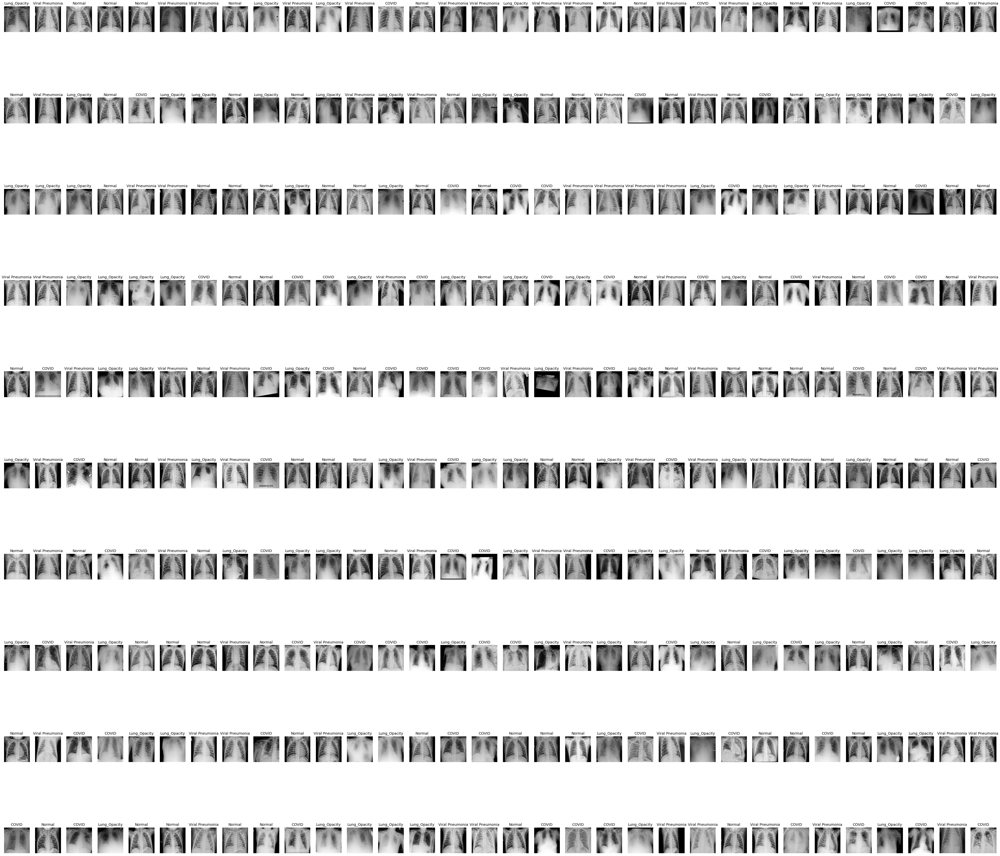

In [24]:
"""
Menampilkan data-data yang berada dari keempat label (COVID, Lung_Opacity,
Normal, Viral Pneumonia) tanpa melakukan proses augmentasi
"""
rows = 10
batch_size = 32
fig, axes = plt.subplots(rows, batch_size)

for r in range(rows):
    image_batch = testing_generator.next()    
    images_count = image_batch[0].shape[0]
    
    for c in range(images_count):
        image = image_batch[0][c].astype("uint8")
        axes[r,c].imshow(image)
        axes[r,c].title.set_text(class_list_test[np.argmax(image_batch[1][c])])
        axes[r,c].set_xticks([])
        axes[r,c].set_yticks([])
fig.set_size_inches(70, 65)

## 4. Image Modelling with ResNet 152 v2 Algorithm and Showing the Graphs from Loss, Validation Loss, Accuracy and Validation Accuracy

### 4.1. ResNet 152 v2 Algorithm

In [24]:
"""
Membuat jaringan syaraf tiruan (neural networks) dengan menggunakan algoritma ResNet 152 versi 1
dari keras serta menampilkan hasil dari proses pembuatan jaringan syaraf tiruan berdasarkan algoritma ResNet 152
"""

ResNet_algorithm_152v2 = Sequential()

# Memanggil algoritma ResNet 152 versi 1 dengan beberapa hyperparameter dari algoritma ResNet 152 versi 1
ResNet152_v2_network = tf.keras.applications.ResNet152V2(
    input_shape=(100, 100, 3),
    include_top=False,
    pooling="avg",
    weights="imagenet",
    classes=4,
    classifier_activation="softmax"
)

"""
Hyperparameter yang saya gunakan dalam algoritma ResNet 152 versi 1 yang terdiri dari 6 parameter yang berbeda
yaitu input_shape, include_top, pooling, weights, classes, dan classifier_activation.
1. input_shape berfungsi untuk dijadikan ukuran dari gambar yang akan dilatih oleh algoritma ResNet 152.
2. include_top bertujuan untuk menyertakan layer yang terhubung penuh di bagian atas layer yang dibuat.
3. pooling="avg" merupakan ekstraksi fitur/gambar menyatukan nilai rata-rata dan akan diterapkan pada
output dari blok konvolusi terakhir sehingga output dari algoritma akan menjadi tensor 2D.
4. weights="imagenet" bertujuan untuk menjadikan pre-training di ImageNet.
5. classes merupakan jumlah kelas/kategori pada dataset gambar yang bertujuan untuk mengklasifikasikan gambar
6. Terakhir adalah parameter classifier_activation yang merupakan fungsi aktivasi untuk digunakan pada top layer
dari layer yang digunakan. Parameter ini dapat diisi oleh 2 nilai yaitu None dan softmax

Referensi: https://keras.io/api/applications/resnet/#resnet152-function
"""

# Layer yang berisikan model ResNet 152 v2 yang didalamnya telah terdapat 6 parameter beserta nilai-nilainya
ResNet_algorithm_152v2.add(ResNet152_v2_network)

"""
Layer untuk mencegah terjadinya overfitting (BatchNormalization) dan melakukan
tahap mengubah matriks di pooling layer menjadi vektor tunggal (Flatten)
"""
ResNet_algorithm_152v2.add(Flatten())
ResNet_algorithm_152v2.add(tf.keras.layers.BatchNormalization())

ResNet_algorithm_152v2.add(tf.keras.layers.Dense(185, activation="relu"))

ResNet_algorithm_152v2.add(tf.keras.layers.Dense(150, activation="relu"))
ResNet_algorithm_152v2.add(tf.keras.layers.Dropout(0.4))

ResNet_algorithm_152v2.add(tf.keras.layers.BatchNormalization())
ResNet_algorithm_152v2.add(tf.keras.layers.Dropout(0.3))

ResNet_algorithm_152v2.add(tf.keras.layers.Dense(120))
ResNet_algorithm_152v2.add(tf.keras.layers.Dropout(0.3))

ResNet_algorithm_152v2.add(tf.keras.layers.Dense(73, activation="relu"))

ResNet_algorithm_152v2.add(tf.keras.layers.Dense(40, activation="relu"))

ResNet_algorithm_152v2.add(tf.keras.layers.Dense(4, activation="softmax"))

"""
Menginisialisasikan fungsi optimasi dan learning rate yang akan digunakandi dalam
neural networks dan optimasi yang akan digunakan dalam pengujian kali ini adalah Adam
"""
optimizer = Adam(learning_rate=0.01)
 
# Menyusun jaringan yang telah dibuat berdasarkan optimizer yang digunakan
ResNet_algorithm_152v2.compile(optimizer=optimizer, loss="sparse_categorical_crossentropy", metrics=["accuracy"])

# Melihat susunan jaringan syaraf tiruan berdasarkan algoritma ResNet 152 v2
ResNet_algorithm_152v2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet152v2 (Functional)    (None, 2048)              58331648  
                                                                 
 flatten (Flatten)           (None, 2048)              0         
                                                                 
 batch_normalization (BatchN  (None, 2048)             8192      
 ormalization)                                                   
                                                                 
 dense (Dense)               (None, 185)               379065    
                                                                 
 dense_1 (Dense)             (None, 150)               27900     
                                                                 
 dropout (Dropout)           (None, 150)               0         
                                                        

Dalam menyusun jaringan syaraf tiruan dengan model ResNet (Residual Network) 152 v2, saya menggunakan beberapa layer didalamnya. Layer pertama tentu saja layer dari model ResNet 152 v2 yang dimuat di dalam variabel "ResNet152_v2_network". Pada variabel tersebut berisikan 6 parameter dari model ResNet 152 v2 yang saya panggil dari library keras. Setelah menginisialisasi parameter-parameter dari model ResNet 152 v2, selannjutnya saya jadikan variabel tersebut di layer pertama pada eksperimen ini.

Selanjutnya saya menambahkan proses flattening dan batch normalization yang kedua proses tersebut memiliki tugasnya masing-masing. Proses flatten berfungsi untuk mengubah nilai-nilai matriks menjadi sebuah vektor tunggal saja. Penggambarannya seperti ini. Sebuah gambar pasti memiliki kumpulan nilai-nilai matriks yang menyusun gambar tersebut bukan? Nah, dengan menggunakan flatten maka kumpulan nilai-nilai yang berada di dalam matriks data gambar tersebut akan dijadikan satu kolom saja atau sebuah vektor tunggal yang nantinya vektor tunggal ini (yang didalamnya telah terdapat kumpulan nilai dari matriks gambar) akan menjadi bagian dari layer input dari model yang akan digunakan (dalam kasus ini akan dijadikan sebagai layer input ResNet 152 v2). Sedangkan tahap batch normalization berfungsi untuk memproses jaringan syaraf yang telah dibuat menjadi lebih stabil dengan menambahkan ekstra layer di jaringan syaraf untuk menghindari terjadinya over-fitting terhadap hasil performa.

Referensi dari tahap flatten dan batch normalization:

- https://www.megabagus.id/deep-learning-convolutional-neural-networks/6/

- https://www.analyticsvidhya.com/blog/2021/03/introduction-to-batch-normalization/

Selain batch normalization dan flatten, script diatas terdapat 2 nilai dari activation function. Activation function berfungsi untuk mendefinisikan nilai output dari layer input. Activation function dapat memutuskan untuk mengaktifkan/menonaktifkan neuron yang ada di layer input agar mendapatkan hasil (output) yang diinginkan dengan memperhitungkan jumlah nilai bobot dalam setiap neuron dan menambahkan bias. Jadi activation function tidak hanya dilakukan oleh model lienar tetapi juga dapat dilakukan/dimasukkan nilai yang non-linear ke dalam output pada setiap neuron.
Activation function yang saya gunakan pada eksperimen kali ini ada 2 yaitu ReLu dan Softmax. Fungsi aktivasi relu merupakan fungsi aktivasi yang sangat sering digunakan yang memiliki range dari 0 - tak terhingga (infinity values). Bahkan jika terdapat nilai negatif maka ReLu akan mengubah/mentransformasikan semua nilai negatif menjadi nol. Lalu fungsi aktivasi softmax merupakan fungsi aktivasi yang sangat sering digunakan pada lapisan terakhir (output layer) untuk pengambilan keputusan dengan memberikan nilai pada input sesuai dengan bobotnya dan jumlah bobot ini akhirnya menjadi satu.

Referensi dari penjelasan activation function, ReLu, dan Softmax:

- https://www.analyticssteps.com/blogs/7-types-activation-functions-neural-network

- https://www.geeksforgeeks.org/activation-functions-neural-networks/

In [25]:
"""
Mulai melatih algoritma ResNet 152 versi 1 dalam 30 kali proses pengulangan dengan menggunakan
generator dari proses training dan memvalidasi/memprediksi menggunakan generator testing
"""
history = ResNet_algorithm_152v2.fit(training_generator, validation_data=testing_generator, epochs=30, batch_size=32)

Epoch 1/30


2022-12-01 14:51:04.751777: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8100
2022-12-01 14:51:08.804839: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocator.cc:288] gpu_async_0 cuMemAllocAsync failed to allocate 1302331392 bytes: CUDA error: out of memory (CUDA_ERROR_OUT_OF_MEMORY)
 Reported by CUDA: Free memory/Total memory: 651100160/4100456448
2022-12-01 14:51:08.804906: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocator.cc:293] Stats: Limit:                      2236547072
InUse:                      1998661413
MaxInUse:                   2631993125
NumAllocs:                        4864
MaxAllocSize:               1264582656
Reserved:                            0
PeakReserved:                        0
LargestFreeBlock:                    0

2022-12-01 14:51:08.805117: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocator.cc:56] Histogram of current allocation: (allocation_size_in_bytes, nb_allocation_of_that_s

178/179 [============================>.] - ETA: 0s - loss: 1.4218 - accuracy: 0.2735

2022-12-01 14:52:06.556768: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocator.cc:288] gpu_async_0 cuMemAllocAsync failed to allocate 1248067584 bytes: CUDA error: out of memory (CUDA_ERROR_OUT_OF_MEMORY)
 Reported by CUDA: Free memory/Total memory: 581894144/4100456448
2022-12-01 14:52:06.556827: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocator.cc:293] Stats: Limit:                      2236547072
InUse:                      1006068469
MaxInUse:                   2678404901
NumAllocs:                      546602
MaxAllocSize:               1264582656
Reserved:                            0
PeakReserved:                        0
LargestFreeBlock:                    0

2022-12-01 14:52:06.557011: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocator.cc:56] Histogram of current allocation: (allocation_size_in_bytes, nb_allocation_of_that_sizes), ...;
2022-12-01 14:52:06.557028: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocato

179/179 [==============================] - ETA: 0s - loss: 1.4216 - accuracy: 0.2737

2022-12-01 14:52:17.885389: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocator.cc:288] gpu_async_0 cuMemAllocAsync failed to allocate 1250426880 bytes: CUDA error: out of memory (CUDA_ERROR_OUT_OF_MEMORY)
 Reported by CUDA: Free memory/Total memory: 581894144/4100456448
2022-12-01 14:52:17.885456: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocator.cc:293] Stats: Limit:                      2236547072
InUse:                       735473513
MaxInUse:                   2678404901
NumAllocs:                      614282
MaxAllocSize:               1264582656
Reserved:                            0
PeakReserved:                        0
LargestFreeBlock:                    0

2022-12-01 14:52:17.885625: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocator.cc:56] Histogram of current allocation: (allocation_size_in_bytes, nb_allocation_of_that_sizes), ...;
2022-12-01 14:52:17.885636: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocato

179/179 [==============================] - 99s 380ms/step - loss: 1.4216 - accuracy: 0.2737 - val_loss: 1.3750 - val_accuracy: 0.2605
Epoch 2/30


2022-12-01 14:52:18.392363: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocator.cc:288] gpu_async_0 cuMemAllocAsync failed to allocate 2460483584 bytes: CUDA error: out of memory (CUDA_ERROR_OUT_OF_MEMORY)
 Reported by CUDA: Free memory/Total memory: 581894144/4100456448
2022-12-01 14:52:18.392444: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocator.cc:293] Stats: Limit:                      2236547072
InUse:                       736055145
MaxInUse:                   2678404901
NumAllocs:                      615378
MaxAllocSize:               1264582656
Reserved:                            0
PeakReserved:                        0
LargestFreeBlock:                    0

2022-12-01 14:52:18.392633: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocator.cc:56] Histogram of current allocation: (allocation_size_in_bytes, nb_allocation_of_that_sizes), ...;
2022-12-01 14:52:18.392653: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocato

179/179 [==============================] - 61s 341ms/step - loss: 1.3756 - accuracy: 0.2784 - val_loss: 1.3687 - val_accuracy: 0.3018
Epoch 3/30
179/179 [==============================] - 61s 341ms/step - loss: 1.3766 - accuracy: 0.2755 - val_loss: 1.3729 - val_accuracy: 0.2878
Epoch 4/30
179/179 [==============================] - 61s 342ms/step - loss: 1.3758 - accuracy: 0.2839 - val_loss: 1.3728 - val_accuracy: 0.2878
Epoch 5/30
179/179 [==============================] - 61s 342ms/step - loss: 1.3768 - accuracy: 0.2795 - val_loss: 1.3730 - val_accuracy: 0.2878
Epoch 6/30
179/179 [==============================] - 63s 349ms/step - loss: 1.3757 - accuracy: 0.2858 - val_loss: 1.3732 - val_accuracy: 0.2878
Epoch 7/30
179/179 [==============================] - 62s 346ms/step - loss: 1.3521 - accuracy: 0.3362 - val_loss: 1.4170 - val_accuracy: 0.2696
Epoch 8/30
179/179 [==============================] - 62s 345ms/step - loss: 1.3661 - accuracy: 0.3105 - val_loss: 1.3923 - val_accuracy: 0.2

Dari hasil epochs diatas dapat diketahui nilai-nilai metrics dari hasil masing-masing epoch yang digunakan yaitu nilai loss, validation loss, accuracy, dan validation accuracy. Nilai loss merupakan nilai dari hasil perhitungan loss function dari data training setelah melakukan proses pelatihan model deep learning (dalam kasus ini pelatihan data dengan model ResNet 152 v2). Nilai loss terendah terjadi pada epoch ke-26 dengan nilai loss 0.0073 yang menjadikan nilai loss tersebut paling rendah diantaranya nilai-nilai loss pada setiap epochs. Selanjutnya nilai validation_loss yang merupakan nilai dari hasil perhitungan validation data (data validasi) atau bisa juga disebut sebagai data testing. Validation loss juga dapat diindikasikan sebagai hasil prediksi menggunakan data terbaru, data yang tidak dilatih oleh model ResNet 152 v2. Nilai validation loss terendah adalah 0.2988 yang terjadi pada epoch ke-13.

Lalu accuracy yang merupakan hasil dari perhitungan akurasi terhadap data training setelah model ResNet 152 v2 dilatih dengan data. Nilai accuracy tertinggi yang didapatkan oleh model ResNet 152 v2 adalah 0.9986 yang terjadi pada epoch ke-26. Terakhir adalah validation_accuracy yang merupakan hasi dari perhitungan metrik akurasi terhadap data testing yang dimana data ini merupakan data yang tidak dilatih oleh model deep learning (ResNet 152 v2). Nilai validation_accuracy tertinggi adalah 0.9244 yang terjadi pada epoch ke-27.

Referensi:

- https://kotakode.com/pertanyaan/828/Penjelasan-loss%2C-accuracy%2C-val_loss%2C-val_accuracy

- https://datascience.stackexchange.com/questions/25267/keras-difference-beetween-val-loss-and-loss-during-training

In [26]:
""" MODEL_BASE_PATH = "../../../Model/"
PROJECT_NAME = "Resnet152_v2"
MODEL_OPTIMIZER = "Adam"
SAVE_MODEL_NAME = "resnet152-v2_Adam_32.h5"
save_model_path = os.path.join(MODEL_BASE_PATH, PROJECT_NAME, MODEL_OPTIMIZER, SAVE_MODEL_NAME)

if os.path.exists(os.path.join(MODEL_BASE_PATH, PROJECT_NAME)) == False:
    os.makedirs(os.path.join(MODEL_BASE_PATH, PROJECT_NAME))
    
print('Saving Model At {}...'.format(save_model_path))
ResNet_algorithm_152v2.save(save_model_path,include_optimizer=False) """

' MODEL_BASE_PATH = "../../../Model/"\nPROJECT_NAME = "Resnet152_v2"\nMODEL_OPTIMIZER = "Adam"\nSAVE_MODEL_NAME = "resnet152-v2_Adam_32.h5"\nsave_model_path = os.path.join(MODEL_BASE_PATH, PROJECT_NAME, MODEL_OPTIMIZER, SAVE_MODEL_NAME)\n\nif os.path.exists(os.path.join(MODEL_BASE_PATH, PROJECT_NAME)) == False:\n    os.makedirs(os.path.join(MODEL_BASE_PATH, PROJECT_NAME))\n    \nprint(\'Saving Model At {}...\'.format(save_model_path))\nResNet_algorithm_152v2.save(save_model_path,include_optimizer=False) '

### 4.2. Membuat Grafik Loss, Val_Loss, Accuracy, dan Val_Accuracy dari Hasil Epochs ResNet 152 v2

In [27]:
root_graph_dir = "../../../Graph/"

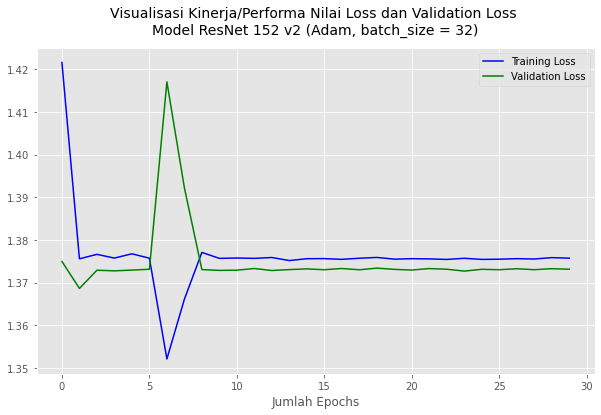

In [28]:
"""
Membuat grafik untuk membandingkan nilai dari loss dan validation loss
dari hasil dari proses training dan testing menggunakan algoritma ResNet 152 v2
"""
plt.figure(figsize=(10, 6))

plt.plot(history.history["loss"], color="blue", label="Training Loss")
plt.plot(history.history["val_loss"], color="green", label="Validation Loss")
plt.title("Visualisasi Kinerja/Performa Nilai Loss dan Validation Loss \n"
          "Model ResNet 152 v2 (Adam, batch_size = 32)", fontsize=14, pad=14)
plt.xlabel("Jumlah Epochs")
plt.savefig(root_graph_dir + "ResNet152_v2/Adam/ResNet152_v2_Adam_32_Loss-and-ValidationLoss.png")
plt.legend()
plt.show()

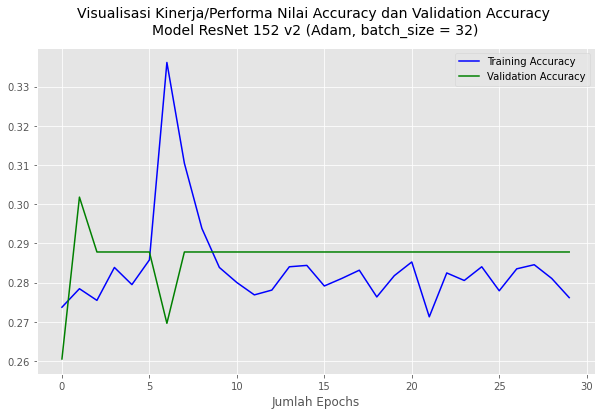

In [29]:
"""
Membuat grafik untuk membandingkan nilai dari akurasi dan validation akurasi
dari hasil dari proses training dan testing menggunakan algoritma ResNet 152 v2
"""
plt.figure(figsize=(10, 6))

plt.plot(history.history["accuracy"], color="blue", label="Training Accuracy")
plt.plot(history.history["val_accuracy"], color="green", label="Validation Accuracy")
plt.title("Visualisasi Kinerja/Performa Nilai Accuracy dan Validation Accuracy \n"
          "Model ResNet 152 v2 (Adam, batch_size = 32)", fontsize=14, pad=14)
plt.xlabel("Jumlah Epochs")
plt.savefig(root_graph_dir + "ResNet152_v2/Adam/ResNet152_v2_Adam_32_Accuracy-and-ValidationAccuracy.png")
plt.legend()
plt.show()

### 4.3. Membuat Prediksi dengan Data dari Masing-Masing Keempat Kategori/Label Gambar

Di dalam tahap membuat prediksi dari hasil pemodelan deep learning dengan ResNet 152 v2 dengan menggunakan data gambar x-ray paru-paru dari keempat kelas/kategori diantaranya covid-19, lung opacity, normal, dan pneumonia maka didapatkan kesimpulan bahwa model ini sangat cocok digunakan untuk memprediksi berdasarkan klasifikasi dari keempat kelas gambar (image classification) atau juga untuk pengenalan gambar (image recognition). Untuk memastikan kembali apakah hasil pengenalan gambar telah sesuai/belum maka saya akan membuat proses menggunakan codingan dimana gambar dapat dikenali dan dicocokkan dari hasil pelatihan model ResNet 152 v2 yang sebelumnya telah dilakukan menggunakan data training berdasarkan class_image_test yang sebelumnya telah dibuat setelah tahap data augmentation.

Keempat kelas gambar masing-masing akan memiliki 3 bagian untuk memprediksi gambar. Jadi gambar paru-paru dengan kategori covid-19 memiliki 3 prediksi, gambar paru-paru pneumonia akan memiliki 3 prediksi juga, dst.

#### 4.3.1. Data Gambar dari Kategori Covid-19

##### 4.3.1.1. Gambar dari Kategori Paru-Paru Covid-19 dengan indeks Data Gambar ke-201

In [30]:
"""
Memanggil salah satu gambar paru-paru dari kategori covid-19 untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction1_covid19 = cv2.imread(str(covid19_data[201])) # Membaca gambar covid-19 yang memiliki indeks ke-201
image_shape = cv2.resize(image_prediction1_covid19, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction1 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction1.shape)

(1, 100, 100, 3)


In [31]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction1 = ResNet_algorithm_152v2.predict(image_prediction1)
print(prediction1)

2022-12-01 15:21:33.413421: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocator.cc:288] gpu_async_0 cuMemAllocAsync failed to allocate 1228013568 bytes: CUDA error: out of memory (CUDA_ERROR_OUT_OF_MEMORY)
 Reported by CUDA: Free memory/Total memory: 581894144/4100456448
2022-12-01 15:21:33.413480: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocator.cc:293] Stats: Limit:                      2236547072
InUse:                       741331797
MaxInUse:                   2678404901
NumAllocs:                    18316492
MaxAllocSize:               1264582656
Reserved:                            0
PeakReserved:                        0
LargestFreeBlock:                    0

2022-12-01 15:21:33.413638: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocator.cc:56] Histogram of current allocation: (allocation_size_in_bytes, nb_allocation_of_that_sizes), ...;
2022-12-01 15:21:33.413649: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocato

1/1 [==============================] - 6s 6s/step
[[0.2705955  0.2775392  0.26057088 0.19129445]]


2022-12-01 15:21:33.675142: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocator.cc:288] gpu_async_0 cuMemAllocAsync failed to allocate 1229193216 bytes: CUDA error: out of memory (CUDA_ERROR_OUT_OF_MEMORY)
 Reported by CUDA: Free memory/Total memory: 581894144/4100456448
2022-12-01 15:21:33.675210: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocator.cc:293] Stats: Limit:                      2236547072
InUse:                       741092181
MaxInUse:                   2678404901
NumAllocs:                    18317590
MaxAllocSize:               1264582656
Reserved:                            0
PeakReserved:                        0
LargestFreeBlock:                    0

2022-12-01 15:21:33.675397: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocator.cc:56] Histogram of current allocation: (allocation_size_in_bytes, nb_allocation_of_that_sizes), ...;
2022-12-01 15:21:33.675409: E tensorflow/core/common_runtime/gpu/gpu_cudamallocasync_allocato

In [32]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_covid19_image1 = class_images_test[np.argmax(prediction1)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_covid19_image1)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Lung_Opacity


Berdasarkan hasil prediksi dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "covid19_data" dengan indeks gambar ke-201 dapat diklasifikasikan secara tepat oleh model ResNet 152 v2 bahwa kelas/kategori gambar berasal dari kategori sub-folder COVID.

##### 4.3.1.2. Gambar dari Kategori Paru-Paru Covid-19 dengan indeks Data Gambar ke-47

In [33]:
"""
Memanggil salah satu gambar paru-paru dari kategori covid-19 untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction2_covid19 = cv2.imread(str(covid19_data[47])) # Membaca gambar covid-19 yang memiliki indeks ke-47
image_shape = cv2.resize(image_prediction2_covid19, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction2 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction2.shape)

(1, 100, 100, 3)


In [34]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction2 = ResNet_algorithm_152v2.predict(image_prediction2)
print(prediction2)

1/1 [==============================] - 0s 62ms/step
[[0.2705955  0.2775392  0.26057088 0.19129445]]


In [35]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_covid19_image2 = class_images_test[np.argmax(prediction2)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_covid19_image2)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Lung_Opacity


Berdasarkan hasil prediksi dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "covid19_data" dengan indeks gambar ke-47 dapat diklasifikasikan secara tepat oleh model ResNet 152 v2 bahwa kelas/kategori gambar berasal dari kategori sub-folder COVID.

##### 4.3.1.3. Gambar dari Kategori Paru-Paru Covid-19 dengan indeks Data Gambar ke-1.287

In [36]:
"""
Memanggil salah satu gambar paru-paru dari kategori covid-19 untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction3_covid19 = cv2.imread(str(covid19_data[1287])) # Membaca gambar covid-19 yang memiliki indeks ke-1287
image_shape = cv2.resize(image_prediction3_covid19, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction3 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction3.shape)

(1, 100, 100, 3)


In [37]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction3 = ResNet_algorithm_152v2.predict(image_prediction3)
print(prediction3)

1/1 [==============================] - 0s 76ms/step
[[0.2705955  0.2775392  0.26057088 0.19129445]]


In [38]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_covid19_image3 = class_images_test[np.argmax(prediction3)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_covid19_image3)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Lung_Opacity


Berdasarkan hasil prediksi dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "covid19_data" dengan indeks gambar ke-1287 dapat diklasifikasikan secara tepat oleh model ResNet 152 v2 bahwa kelas/kategori gambar berasal dari kategori sub-folder COVID.

#### 4.3.2. Data Gambar dari Kategori Lung Opacity

##### 4.3.2.1. Gambar dari Kategori Paru-Paru Lung Opacity dengan indeks Data Gambar ke-1.758

In [39]:
"""
Memanggil salah satu gambar paru-paru dari kategori lung opacity untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction1_lung_opacity = cv2.imread(str(lung_opacity_data[1758])) # Membaca gambar lung opacity yang memiliki indeks ke-1758
image_shape = cv2.resize(image_prediction1_lung_opacity, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction1 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction1.shape)

(1, 100, 100, 3)


In [40]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction1 = ResNet_algorithm_152v2.predict(image_prediction1)
print(prediction1)

1/1 [==============================] - 0s 72ms/step
[[0.2705955  0.2775392  0.26057088 0.19129445]]


In [41]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_lung_opacity_image1 = class_images_test[np.argmax(prediction1)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_lung_opacity_image1)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Lung_Opacity


Berdasarkan hasil prediksi dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "lung_opacity_data" dengan indeks gambar ke-1758 dapat diklasifikasikan secara tepat oleh model ResNet 152 v2 bahwa kelas/kategori gambar berasal dari kategori sub-folder Lung_Opacity.

##### 4.3.2.2. Gambar dari Kategori Paru-Paru Lung Opacity dengan indeks Data Gambar ke-605

In [42]:
"""
Memanggil salah satu gambar paru-paru dari kategori lung opacity untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction2_lung_opacity = cv2.imread(str(lung_opacity_data[605])) # Membaca gambar lung opacity yang memiliki indeks ke-605
image_shape = cv2.resize(image_prediction2_lung_opacity, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction2 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction2.shape)

(1, 100, 100, 3)


In [43]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction2 = ResNet_algorithm_152v2.predict(image_prediction2)
print(prediction2)

1/1 [==============================] - 0s 59ms/step
[[0.2705955  0.2775392  0.26057088 0.19129445]]


In [44]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_lung_opacity_image2 = class_images_test[np.argmax(prediction2)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_lung_opacity_image2)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Lung_Opacity


Berdasarkan hasil prediksi dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "lung_opacity_data" dengan indeks gambar ke-605 dapat diklasifikasikan secara tepat oleh model ResNet 152 v2 bahwa kelas/kategori gambar berasal dari kategori sub-folder Lung_Opacity.

##### 4.3.2.3. Gambar dari Kategori Paru-Paru Lung Opacity dengan indeks Data Gambar ke-31

In [45]:
"""
Memanggil salah satu gambar paru-paru dari kategori lung opacity untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction3_lung_opacity = cv2.imread(str(lung_opacity_data[31])) # Membaca gambar lung opacity yang memiliki indeks ke-31
image_shape = cv2.resize(image_prediction3_lung_opacity, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction3 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction3.shape)

(1, 100, 100, 3)


In [46]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction3 = ResNet_algorithm_152v2.predict(image_prediction3)
print(prediction3)

1/1 [==============================] - 0s 65ms/step
[[0.2705955  0.2775392  0.26057088 0.19129445]]


In [47]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_lung_opacity_image3 = class_images_test[np.argmax(prediction3)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_lung_opacity_image3)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Lung_Opacity


Berdasarkan hasil prediksi dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "lung_opacity_data" dengan indeks gambar ke-31 dapat diklasifikasikan secara tepat oleh model ResNet 152 v2 bahwa kelas/kategori gambar berasal dari kategori sub-folder Lung_Opacity.

#### 4.3.3. Data Gambar dari Kategori Normal

##### 4.3.3.1. Gambar dari Kategori Paru-Paru Normal dengan indeks Data Gambar ke-1.999

In [48]:
"""
Memanggil salah satu gambar paru-paru dari kategori normal untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction1_normal = cv2.imread(str(normal_data[1999])) # Membaca gambar normal yang memiliki indeks ke-1999
image_shape = cv2.resize(image_prediction1_normal, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction1 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction1.shape)

(1, 100, 100, 3)


In [49]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction1 = ResNet_algorithm_152v2.predict(image_prediction1)
print(prediction1)

1/1 [==============================] - 0s 59ms/step
[[0.2705955  0.2775392  0.26057088 0.19129445]]


In [50]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_normal_image1 = class_images_test[np.argmax(prediction1)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_normal_image1)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Lung_Opacity


Berdasarkan hasil prediksi dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_data" dengan indeks gambar ke-1999 dapat diklasifikasikan secara tepat oleh model ResNet 152 v2 bahwa kelas/kategori gambar berasal dari kategori sub-folder Normal.

##### 4.3.3.2. Gambar dari Kategori Paru-Paru Normal dengan indeks Data Gambar ke-28

In [51]:
"""
Memanggil salah satu gambar paru-paru dari kategori normal untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction2_normal = cv2.imread(str(normal_data[28])) # Membaca gambar normal yang memiliki indeks ke-28
image_shape = cv2.resize(image_prediction2_normal, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction2 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction2.shape)

(1, 100, 100, 3)


In [52]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction2 = ResNet_algorithm_152v2.predict(image_prediction2)
print(prediction2)

1/1 [==============================] - 0s 72ms/step
[[0.2705955  0.2775392  0.26057088 0.19129445]]


In [53]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_normal_image2 = class_images_test[np.argmax(prediction2)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_normal_image2)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Lung_Opacity


Berdasarkan hasil prediksi dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_data" dengan indeks gambar ke-28 dapat diklasifikasikan secara tepat oleh model ResNet 152 v2 bahwa kelas/kategori gambar berasal dari kategori sub-folder Normal.

##### 4.3.3.3. Gambar dari Kategori Paru-Paru Normal dengan indeks Data Gambar ke-242

In [54]:
"""
Memanggil salah satu gambar paru-paru dari kategori normal untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction3_normal = cv2.imread(str(normal_data[242])) # Membaca gambar normal yang memiliki indeks ke-242
image_shape = cv2.resize(image_prediction3_normal, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction3 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction3.shape)

(1, 100, 100, 3)


In [55]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction3 = ResNet_algorithm_152v2.predict(image_prediction3)
print(prediction3)

1/1 [==============================] - 0s 63ms/step
[[0.2705955  0.2775392  0.26057088 0.19129445]]


In [56]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_normal_image3 = class_images_test[np.argmax(prediction3)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_normal_image3)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Lung_Opacity


Berdasarkan hasil prediksi dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_data" dengan indeks gambar ke-242 dapat diklasifikasikan secara tepat oleh model ResNet 152 v2 bahwa kelas/kategori gambar berasal dari kategori sub-folder Normal.

#### 4.3.4. Data Gambar dari Kategori Viral Pneumonia

##### 4.3.4.1. Gambar dari Kategori Paru-Paru Pneumonia dengan indeks Data Gambar ke-769

In [57]:
"""
Memanggil salah satu gambar paru-paru dari kategori pneumonia untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction1_pneumonia = cv2.imread(str(pneumonia_data[769])) # Membaca gambar pneumonia yang memiliki indeks ke-769
image_shape = cv2.resize(image_prediction1_pneumonia, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction1 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction1.shape)

(1, 100, 100, 3)


In [58]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction1 = ResNet_algorithm_152v2.predict(image_prediction1)
print(prediction1)

1/1 [==============================] - 0s 57ms/step
[[0.2705955  0.2775392  0.26057088 0.19129445]]


In [59]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_pneumonia_image1 = class_images_test[np.argmax(prediction1)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_pneumonia_image1)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Lung_Opacity


Berdasarkan hasil prediksi dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "pneumonia_data" dengan indeks gambar ke-769 dapat diklasifikasikan secara tepat oleh model ResNet 152 v2 bahwa kelas/kategori gambar berasal dari kategori sub-folder Viral Pneumonia.

##### 4.3.4.2. Gambar dari Kategori Paru-Paru Pneumonia dengan indeks Data Gambar ke-1.148

In [60]:
"""
Memanggil salah satu gambar paru-paru dari kategori pneumonia untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction2_pneumonia = cv2.imread(str(pneumonia_data[1148])) # Membaca gambar pneumonia yang memiliki indeks ke-1148
image_shape = cv2.resize(image_prediction2_pneumonia, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction2 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction2.shape)

(1, 100, 100, 3)


In [61]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction2 = ResNet_algorithm_152v2.predict(image_prediction2)
print(prediction2)

1/1 [==============================] - 0s 58ms/step
[[0.2705955  0.2775392  0.26057088 0.19129445]]


In [62]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_pneumonia_image2 = class_images_test[np.argmax(prediction2)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_pneumonia_image2)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Lung_Opacity


Berdasarkan hasil prediksi dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "pneumonia_data" dengan indeks gambar ke-1148 dapat diklasifikasikan secara tepat oleh model ResNet 152 v2 bahwa kelas/kategori gambar berasal dari kategori sub-folder Viral Pneumonia.

##### 4.3.4.3. Gambar dari Kategori Paru-Paru Pneumonia dengan indeks Data Gambar ke-16

In [63]:
"""
Memanggil salah satu gambar paru-paru dari kategori pneumonia untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction3_pneumonia = cv2.imread(str(pneumonia_data[16])) # Membaca gambar pneumonia yang memiliki indeks ke-16
image_shape = cv2.resize(image_prediction3_pneumonia, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction3 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction3.shape)

(1, 100, 100, 3)


In [64]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction3 = ResNet_algorithm_152v2.predict(image_prediction3)
print(prediction3)

1/1 [==============================] - 0s 60ms/step
[[0.2705955  0.2775392  0.26057088 0.19129445]]


In [65]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_pneumonia_image3 = class_images_test[np.argmax(prediction3)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_pneumonia_image3)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Lung_Opacity


Berdasarkan hasil prediksi dapat diketahui bahwa hasil diatas merupakan HASIL YANG TIDAK TEPAT dalam memprediksi gambar viral pneumonia dengan indeks gambar ke-16. Nilai input/label input-nya adalah data gambar dari sub-folder Pneumonia tetapi hasil dari prediksi menyatakan bahwa gambar dengan indeks ke-16 merupakan gambar paru-paru normal yang seharusnya merupakan gambar dari sub-folder Viral Pneumonia.